# First checkpoint

In [2]:
# PATH = "drive/MyDrive/mgr/diffusion/result_path_jupyter/shared"
PATH = ".." # local
# DATA_DIR = "result_path_jupyter/data"
DATA_DIR = "data" # local

In [3]:

# from google.colab import drive
# drive.mount('/content/drive/')

In [4]:
# !ls $PATH/result_path_jupyter/data

In [5]:
# !pip install diffusers transformers accelerate datasets

In [1]:
import os
import textwrap

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import requests
import torch
import torchvision.transforms as transforms
from datasets import load_dataset
from diffusers import StableDiffusionPipeline
from PIL import Image, ImageDraw, ImageFont
from torch.utils.data import DataLoader
from torchmetrics.image.fid import FrechetInceptionDistance
from torchvision.utils import make_grid
from tqdm import tqdm

from map_generation.osm_dataset import create_sentence, TextToImageDataset

In [3]:
model_path = "mprzymus/map_diffusion_lora"
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, safety_checker=None)
pipe.unet.load_attn_procs(model_path)
pipe = pipe.to("cuda")

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


## Save samples

In [4]:
def save_img(start_id: int, imgs: list[Image.Image], dir: str):
    for i, img in enumerate(imgs):
        path = os.path.join(PATH, DATA_DIR, dir, f"{i+start_id}.png")
        img.save(path)


def generate_images(
    model: StableDiffusionPipeline, ds, batch_size=16, start=0, dir="gen_lora"
):
    for i in tqdm(range(start, ds.num_rows, batch_size)):
        prompts = ds["caption"][i : i + batch_size]
        imgs = model(prompt=prompts, height=256, width=256).images
        save_img(i, imgs, dir)

In [5]:
def to_tensor(examples):
    if "image" in examples:
        examples["image"] = [transform(image.convert("RGB")) for image in examples["image"]]
    return examples

ds = TextToImageDataset("../data/tiles_own_no_masks").to_huggingface_dataset()["train"]
ds = ds.shuffle(seed=2137)
ds.set_transform(to_tensor)

transform = transforms.Compose([transforms.ToTensor()])
ds = ds.train_test_split(train_size=10000)["train"]
ds

None


Resolving data files:   0%|          | 0/164724 [00:00<?, ?it/s]

Found cached dataset imagefolder (/home/marcin/.cache/huggingface/datasets/imagefolder/tiles_own_no_masks-fd188ee3ca22683d/0.0.0/37fbb85cc714a338bea574ac6c7d0b5be5aff46c1862c1989b20e0771199e93f)


  0%|          | 0/1 [00:00<?, ?it/s]

Loading cached processed dataset at /home/marcin/.cache/huggingface/datasets/imagefolder/tiles_own_no_masks-fd188ee3ca22683d/0.0.0/37fbb85cc714a338bea574ac6c7d0b5be5aff46c1862c1989b20e0771199e93f/cache-be60e8db326fbb1b.arrow
Loading cached shuffled indices for dataset at /home/marcin/.cache/huggingface/datasets/imagefolder/tiles_own_no_masks-fd188ee3ca22683d/0.0.0/37fbb85cc714a338bea574ac6c7d0b5be5aff46c1862c1989b20e0771199e93f/cache-2ce78e8a0c92be7c.arrow


Dataset({
    features: ['image', 'caption'],
    num_rows: 10000
})

In [6]:
def count_fidelity(dir: str, dataloader: DataLoader):
    path = os.path.join(PATH, DATA_DIR, dir)
    fid = FrechetInceptionDistance(normalize=True)
    for i, imgs in enumerate(tqdm(dataloader)):
        gen_imgs = []
        for j in range(imgs.shape[0]):
            img_number = dataloader.batch_size * i + j
            img_path = os.path.join(path, f"{img_number}.png")
            gen_imgs.append(transform(Image.open(img_path)))
        gen_imgs = torch.stack(gen_imgs)
        fid.update(imgs, real=True)
        fid.update(gen_imgs, real=False)
    return fid.compute()

In [7]:
dl = DataLoader(ds["image"], batch_size=64)
dl.batch_size

64

In [11]:
ds.push_to_hub("mprzymus/tiles_test")

Map:   0%|          | 0/10000 [00:00<?, ? examples/s]

Pushing dataset shards to the dataset hub:   0%|          | 0/1 [00:00<?, ?it/s]

Creating parquet from Arrow format:   0%|          | 0/10 [00:00<?, ?ba/s]

Upload 1 LFS files:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
!mkdir -p ../data/gen_lora
generate_images(pipe, ds, dir="gen_lora", start=3808)

In [13]:
count_fidelity("gen_lora", dl)

100%|██████████| 157/157 [16:19<00:00,  6.24s/it]


tensor(60.5333)

# City comparison

In [22]:
!mkdir ../results/

In [2]:
# prompts = [
#     "6 building retails , 37 building residentials , 14 buildings , 7 highway services , 1 landuse religious.",
#     "3 highway footways , 3 amenity parking spaces , 3 building apartmentss , 12 buildings , 1 building school.",
#     "1 waterway stream, 1 sport swimming, 3 highway cycleways , 3 leisure pitchs , 7 amenity parkings .",
#     "2 leisure playgrounds , 12 highway living streets , 1 amenity school, 4 highway tracks , 2 amenity benchs .",
#     "1 building apartments, 2 highway footways , 15 highway residentials , 157 buildings , 1 amenity bench."
# ]

In [21]:
from functional import seq

def generate_samples_for_prompts(dir="../results/"):
    exists = os.listdir(dir)
    with open("../data/cities.txt", "r") as cities_file:
        for city in tqdm(cities_file):
            city = city.replace("\n", "")
            if city in exists:
                continue
            for i in range(2):
                geocode = pd.read_json(
                    f"../data/tiles_own/{city}/metadata.jsonl", lines=True, nrows=1
                )
                geocode = geocode["geocode"].item()
                city_prompt = (
                    seq(prompts)
                    .map(lambda x: f"OSM from {geocode} of city area containing: {x}")
                    .to_list()
                )
                images = pipe(prompt=city_prompt, num_images_per_prompt=1, height=256, width=256).images
                for p, img in zip(city_prompt, images):
                    city_path = os.path.join(dir, city)
                    os.makedirs(city_path, exist_ok=True)
                    img.save(f"{city_path}/{p}_{i}.png")
                    del img

In [22]:
def compare_area_types(prompt_template, to_put):
    for area_type in to_put:
        imgs = pipe(
            prompt=prompt_template.format(area_type=area_type), num_images_per_prompt=4, height=256, width=256
        ).images
        fig = plt.figure(figsize=(15, 7))

        for i in range(len(imgs)):
            fig.add_subplot(1, len(imgs), i + 1)
            plt.imshow(imgs[i])
            plt.axis("off")
        fig.suptitle(area_type.upper(), fontsize=30)
        plt.show()


def generate_examples(
    prompt_template: str, cities, prompt_label: str, negative_prompt: str = ""
):
    if prompt_label != "":
        img = [make_caption(prompt_label)]
    else:
        img = []
    prompts = []
    for city in cities:
        prompts.append(prompt_template.format(area_type=city))
    return img + pipe(
        prompt=prompts, negative_prompt=[negative_prompt] * len(prompts), height=256, width=256
    ).images


def make_caption(prompt_label):
    img = Image.fromarray(np.ones(shape=(256, 256)) * 255).convert("RGB")
    font = ImageFont.truetype("/usr/share/fonts/carlito/Carlito-Regular.ttf", size=30)
    draw = ImageDraw.Draw(img)
    lines = textwrap.wrap(prompt_label, width=20)
    draw.multiline_text((8, 123), "\n".join(lines), fill="black", font=font)
    return img

In [23]:
def list_to_grid(imgs: list[list[Image.Image]], row: int = len(sentences) + 2):
    to_tensor = transforms.PILToTensor()
    imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
    grid = make_grid(imgs, nrow=row)
    grid = transforms.ToPILImage()(grid)
    return grid

# Data examples

In [24]:
from srai.regionizers import SlippyMapRegionizer

def get_data(long, lat):
    x, y = SlippyMapRegionizer(zoom=16)._coordinates_to_x_y(long, lat)
    return f"{x}_{y}_16", f"https://www.openstreetmap.org/#map=16/{long}/{lat}", f"https://tile.openstreetmap.de/16/{x}/{y}.png"

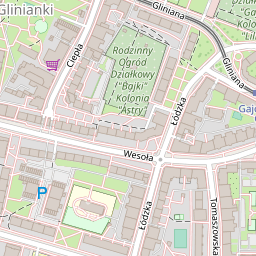

('35869_21913_16',
 'https://www.openstreetmap.org/#map=16/51.0899/17.0396',
 'https://tile.openstreetmap.de/16/35869/21913.png')

In [25]:
#huby
wroclaw = get_data(51.0899, 17.0396)
display(Image.open(requests.get(wroclaw[2], stream=True).raw))
wroclaw

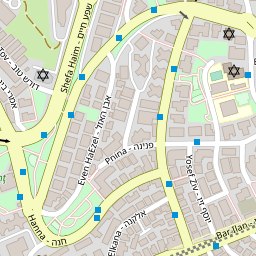

('39178_26657_16',
 'https://www.openstreetmap.org/#map=16/31.7946/35.2152',
 'https://tile.openstreetmap.de/16/39178/26657.png')

In [26]:
# na oko wszystko podobnie, jeruzalem jest ciekawe
jerusalem = get_data(31.7946, 35.2152)
display(Image.open(requests.get(jerusalem[2], stream=True).raw))
jerusalem

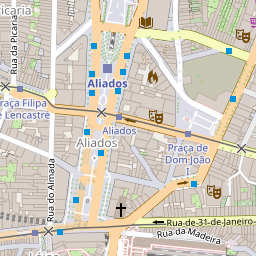

('31200_24535_16',
 'https://www.openstreetmap.org/#map=16/41.14785/-8.61118',
 'https://tile.openstreetmap.de/16/31200/24535.png')

In [27]:
# centrum miasta, porto jest ciekawym miastem ze względu na szerokie ulice
porto = get_data(41.14785, -8.61118)
display(Image.open(requests.get(porto[2], stream=True).raw))
porto

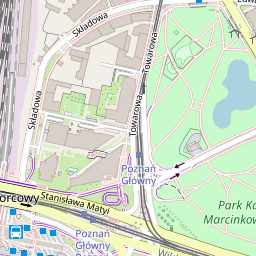

('35847_21527_16',
 'https://www.openstreetmap.org/#map=16/52.4031/16.918',
 'https://tile.openstreetmap.de/16/35847/21527.png')

In [28]:
# obrzeża, plac zabaw
park = get_data(52.4031, 16.918)
display(Image.open(requests.get(park[2], stream=True).raw))
park

In [29]:
df = pd.read_json(f"../data/tiles_own/Poznań, PL/metadata.jsonl", lines=True)
item = df[df["file_name"] == f"{park[0]}.png"].squeeze()
"leisure park" in create_sentence(item, n_columns=1000)

True

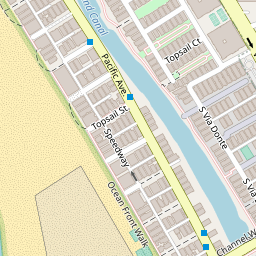

('11203_26186_16',
 'https://www.openstreetmap.org/#map=16/33.9677/-118.4557',
 'https://tile.openstreetmap.de/16/11203/26186.png')

In [30]:
# nadbrzeże
la = get_data(33.9677, -118.4557)
display(Image.open(requests.get(la[2], stream=True).raw))
la

In [31]:
def get_sentence(city: str, img_id, replace_city_with=None):
    df = pd.read_json(f"../data/tiles_own/{city}/metadata.jsonl", lines=True)
    item = df[df["file_name"] == f"{img_id}.png"].squeeze()
    string = create_sentence(item, n_columns=10)
    city = item["geocode"]
    if replace_city_with is not None:
        string = string.replace(city, replace_city_with)
    return string

def get_city_name(city: str):
    df = pd.read_json(f"../data/tiles_own/{city}/metadata.jsonl", lines=True)
    item = df.iloc[0]
    city = item["geocode"]
    return city

In [63]:
to_replace = "{area_type}"
sentences = [
    get_sentence("Wrocław, PL", wroclaw[0], to_replace),
    # get_sentence("Jerusalem, Izrael", jerusalem[0], to_replace),
    get_sentence("Porto, Portugal", porto[0], to_replace),
    get_sentence("Poznań, PL", park[0], to_replace),
    get_sentence("Los Angeles, USA", la[0], to_replace),
]
cities = [
    get_city_name("Wrocław, PL"),
    get_city_name("Jerusalem, Izrael"),
    get_city_name("Lisbon, Portugal"),
    get_city_name("Stockholm, Sweden"),
    get_city_name("Los Angeles, USA"),
    
]

sentences


['OSM from {area_type} of suburb area containing: 1 shop bakery, 7 highway stepss , 3 landuse village greens , 1 highway mini roundabout, 2 amenity schools , 2 railway trams , 76 highway services , 2 amenity pharmacys , 2 building services , 2 landuse allotmentss .',
 'OSM from {area_type} of suburb area containing: 11 amenity vending machines , 23 tourism hotels , 5 tourism attractions , 3 shop perfumerys , 3 shop watchess , 1 leisure escape game, 3 shop lotterys , 8 railway level crossings , 9 tourism hostels , 1 building construction.',
 'OSM from {area_type} of neighbourhood area containing: 1 historic fort, 3 railway railway crossings , 2 tourism artworks , 1 office lawyer, 1 amenity pub, 1 amenity waste disposal, 3 building roofs , 1 amenity restaurant, 3 railway tram level crossings , 13 railway rails .',
 'OSM from {area_type} of area containing: 15 highway residentials , 24 highway paths , 4 highway bus stops , 4 leisure parks , 16 highway footways , 1 landuse residential, 1 w

In [66]:
sentences = [
    'OSM from {area_type} of suburb area containing: 1 amenity kindergarten, 2 landuse allotmentss , 1 building kindergarten, 2 amenity waste disposals , 1 shop beauty, 2 building retails , 1 landuse commercial, 2 amenity pharmacys , 3 amenity recyclings , 3 sport basketballs . ',
    'OSM from {area_type} of suburb area containing: 1 building garages, 1 shop pastry, 6 tourism informations , 16 highway residentials , 23 tourism hotels, 3 shop greengrocers , 1 railway proposed, 1 office religion, 1 shop locksmith, 1 shop bicycle. ',
    'OSM from {area_type} of neighbourhood area containing: 3 amenity bicycle parkings , 18 amenity parkings , 20 highway stepss , 1 historic fort, 2 amenity fast foods , 2 shop opticians , 1 sport chess, 3 historic memorials , 1 leisure park , 16 highway tertiarys .',
    'OSM from {area_type} of area containing: 3 highway pedestrians , 1 natural beach, 15 highway residentials , 1 sport basketball, 18 building apartmentss , 17 highway services , 1 landuse residential, 38 building residentials , 1 natural sand, 6 highway tertiarys .',
]

In [34]:
green_prompt = "OSM from {area_type}, Europe of city area containing: 1 highway track, 6 landuse forests , 3 highway footways , 2 landuse farmland , 1 buildings."

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

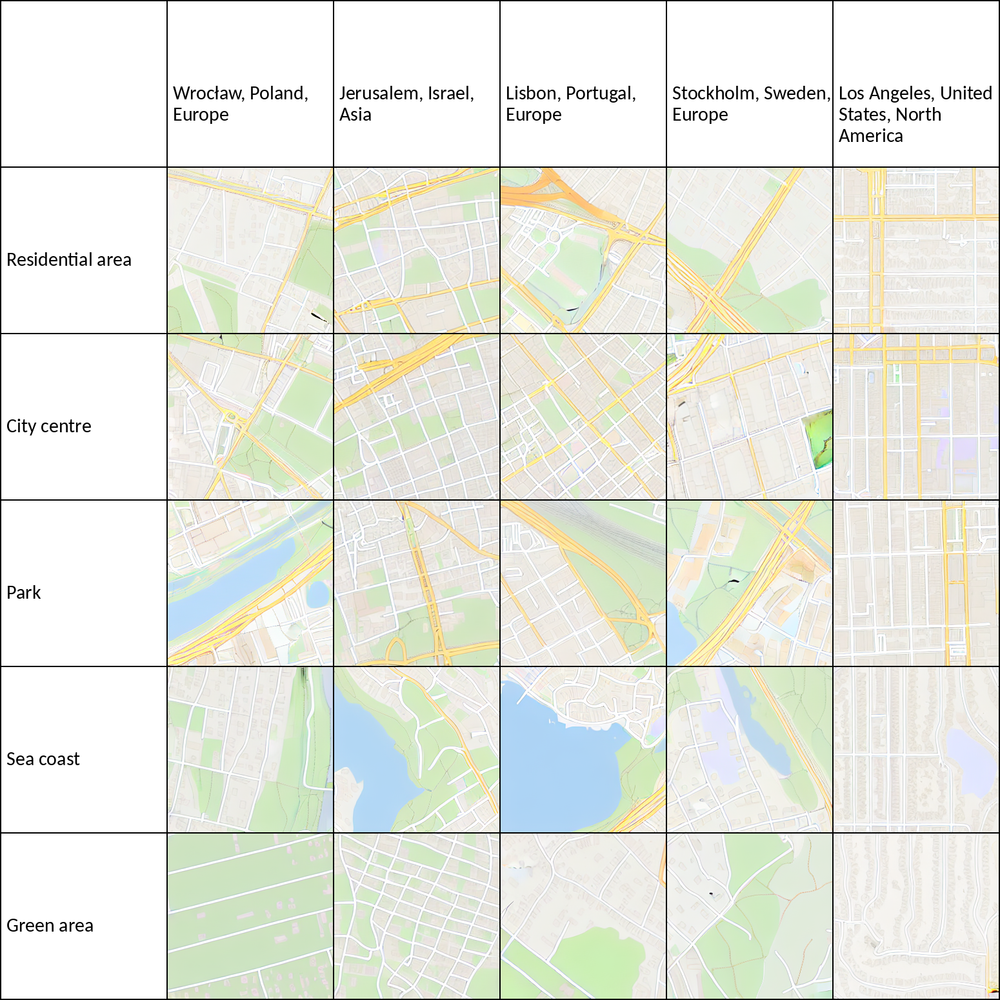

In [64]:

imgs = []
types = ["Residential area", "City centre", "Park", "Sea coast", "Green area"]
for city in [""] + cities:
    imgs.append([make_caption(city)])
for label, sentence in zip(types, sentences + [green_prompt]):
    imgs.append(generate_examples(sentence, cities, label))
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=len(sentences) + 2)
grid = transforms.ToPILImage()(grid)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

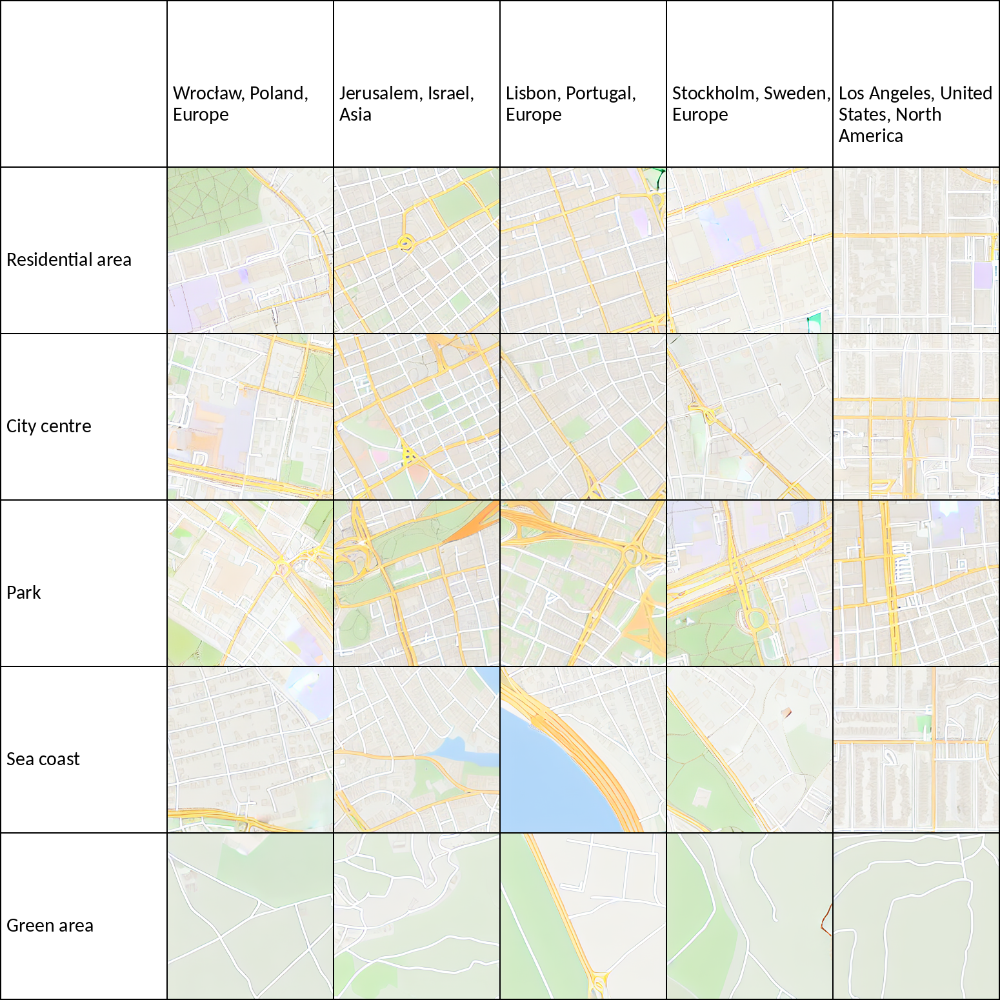

In [36]:

imgs = []
types = ["Residential area", "City centre", "Park", "Sea coast", "Green area"]
for city in [""] + cities:
    imgs.append([make_caption(city)])
for label, sentence in zip(types, sentences + [green_prompt]):
    imgs.append(generate_examples(sentence, cities, label, "park, parks"))
grid = list_to_grid(imgs)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

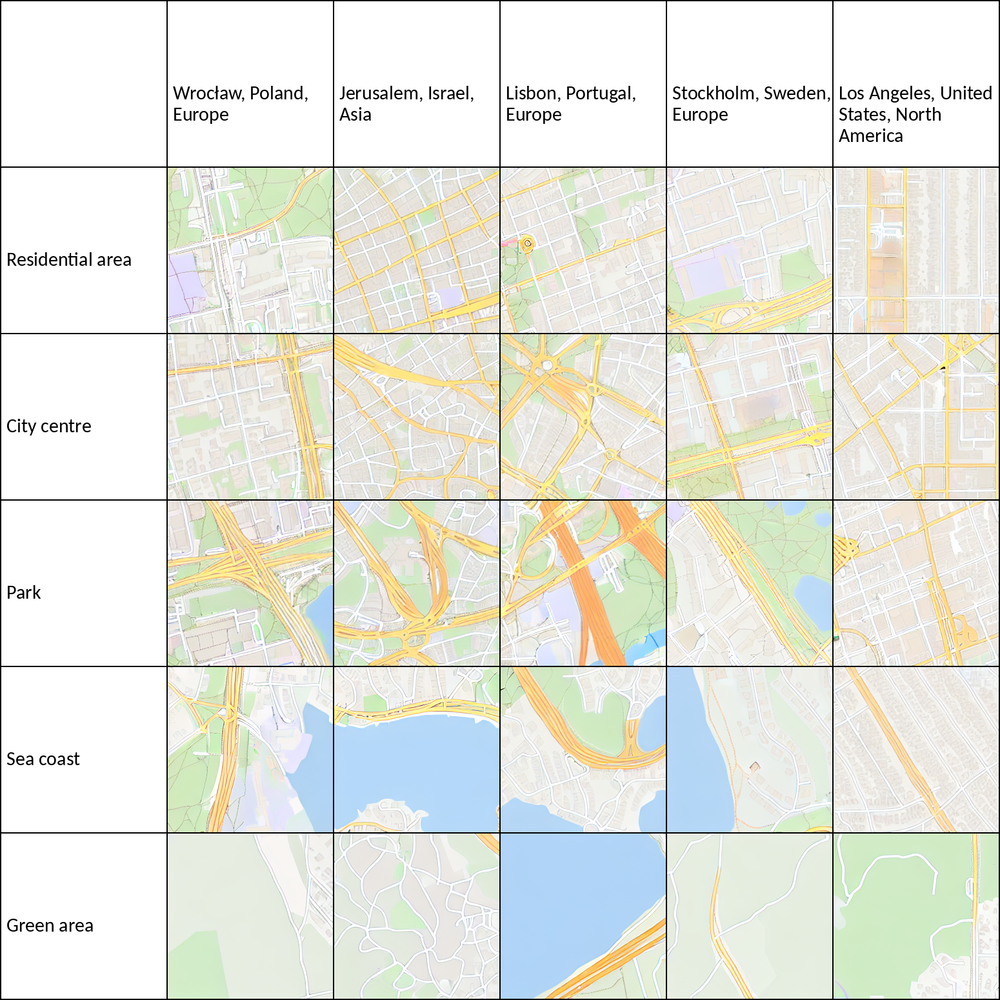

In [37]:

imgs = []
types = ["Residential area", "City centre", "Park", "Sea coast", "Green area"]
for city in [""] + cities:
    imgs.append([make_caption(city)])
for label, sentence in zip(types, sentences + [green_prompt]):
    imgs.append(generate_examples(sentence, cities, label, "allotment, allotments"))
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=len(sentences) + 2)
grid = transforms.ToPILImage()(grid)
grid

In [38]:
sentences

['OSM from {area_type} of suburb area containing: 1 amenity kindergarten, 2 landuse allotmentss , 1 building kindergarten, 2 amenity waste disposals , 1 shop beauty, 2 building retails , 1 landuse commercial, 2 amenity pharmacys , 3 amenity recyclings , 3 sport basketballs . ',
 'OSM from {area_type} of suburb area containing: 1 building garages, 1 shop pastry, 6 tourism informations , 16 highway residentials , 23 tourism hotels, 3 shop greengrocers , 1 railway proposed, 1 office religion, 1 shop locksmith, 1 shop bicycle. ',
 'OSM from {area_type} of neighbourhood area containing: 3 amenity bicycle parkings , 18 amenity parkings , 20 highway stepss , 1 historic fort, 2 amenity fast foods , 2 shop opticians , 1 sport chess, 3 historic memorials , 1 leisure park , 16 highway tertiarys .',
 'OSM from {area_type} of area containing: 3 highway pedestrians , 1 natural beach, 15 highway residentials , 1 sport basketball, 18 building apartmentss , 17 highway services , 1 landuse residential, 

# Miksowanie typu miejsca

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

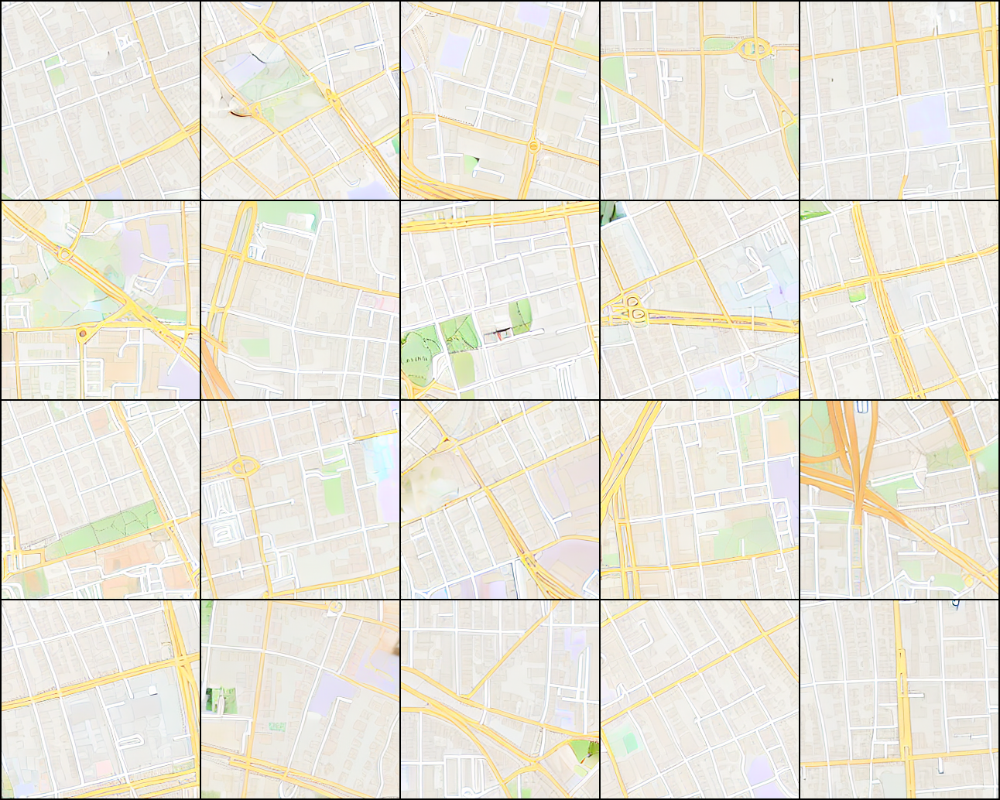

In [61]:
imgs = []
for i in range(20):
    generated = pipe(prompt=sentences[1].format(area_type="Los Angeles, Stockholm, Sweden, Europe"), num_images_per_prompt=4, height=256, width=256).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs[:20], nrow=5)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

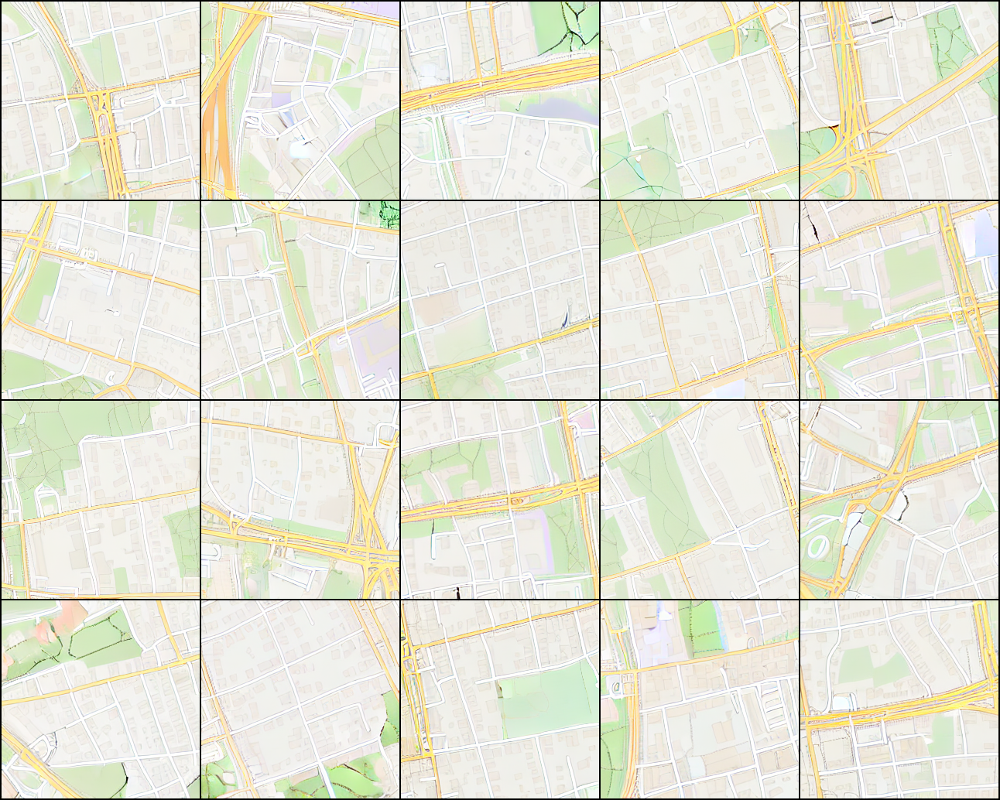

In [40]:
imgs = []
for i in range(5):
    generated = pipe(prompt=sentences[1].format(area_type="Wrocław, Stockholm, Sweden, Europe"), num_images_per_prompt=4, height=256, width=256).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=5)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

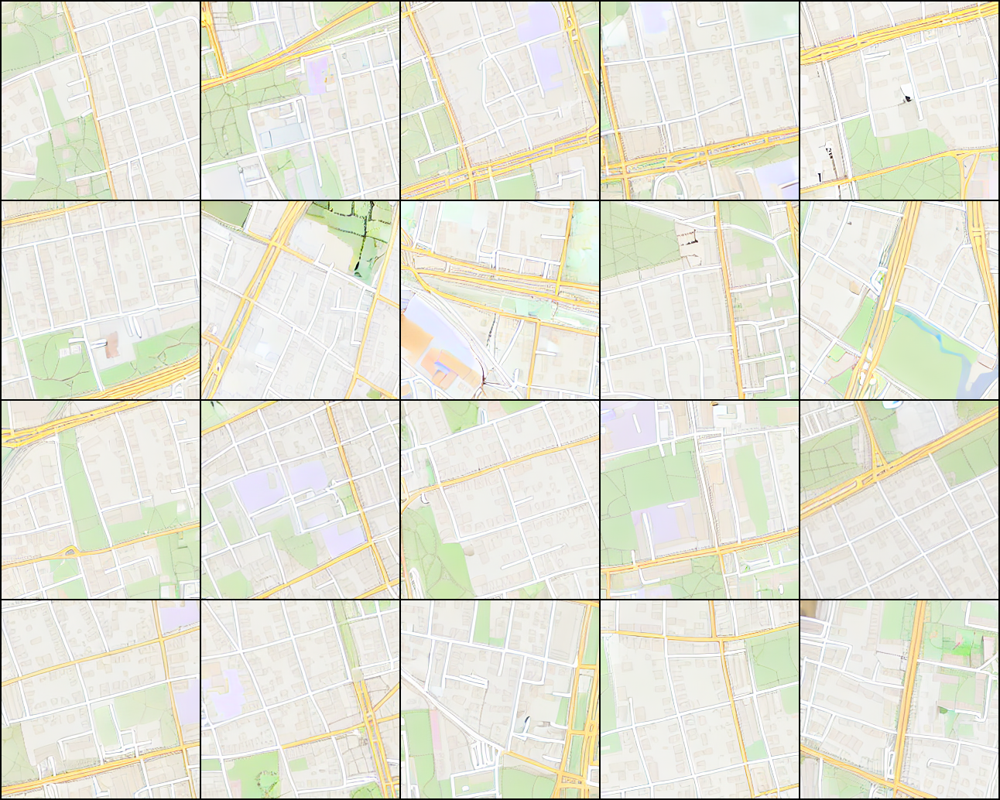

In [41]:
imgs = []
for i in range(5):
    generated = pipe(prompt=sentences[1].format(area_type="Wrocław, PL, Europe"), num_images_per_prompt=4, height=256, width=256).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=5)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

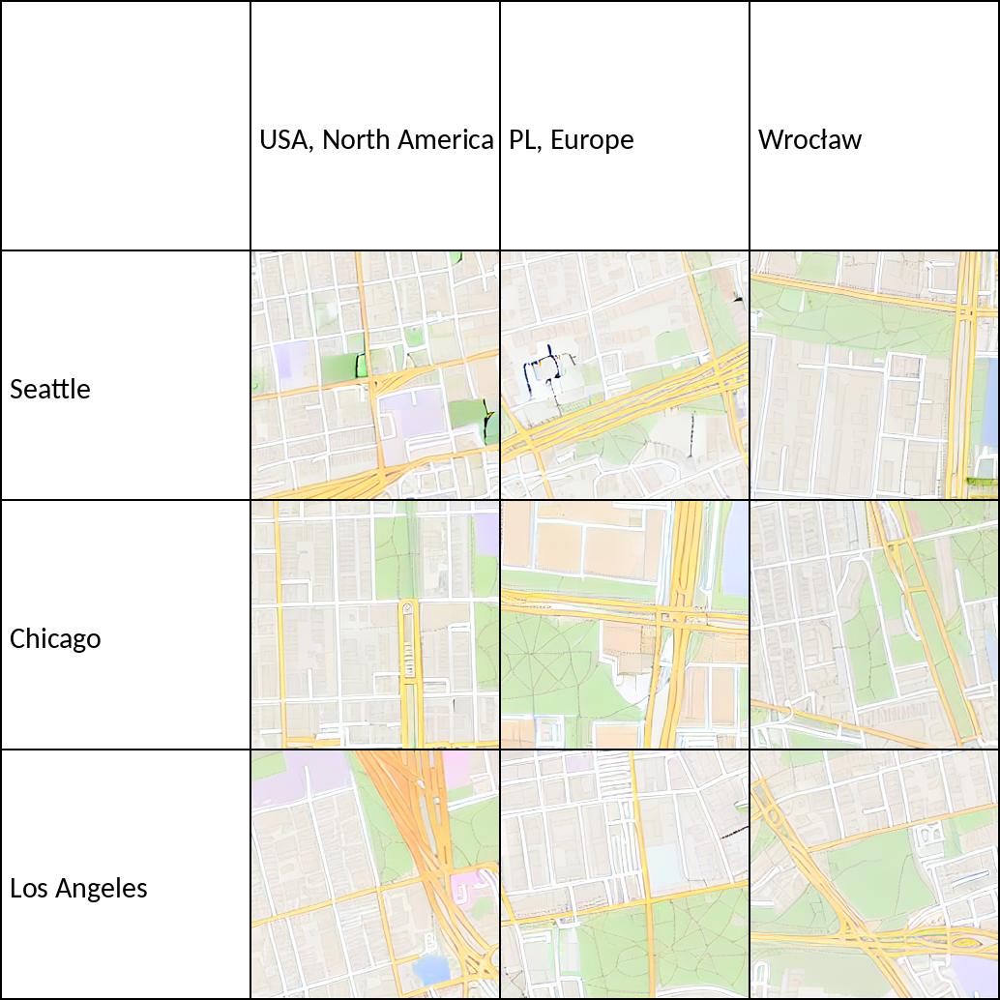

In [67]:
combinations = ["USA, North America", "PL, Europe", "Wrocław"]
imgs = [[make_caption(c) for c in [""] + combinations]]
for city in ["Seattle", "Chicago", "Los Angeles"]:
    mixtures = [city + ", " + c for c in combinations]
    imgs.append(generate_examples(sentences[2], mixtures, city))
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=4)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

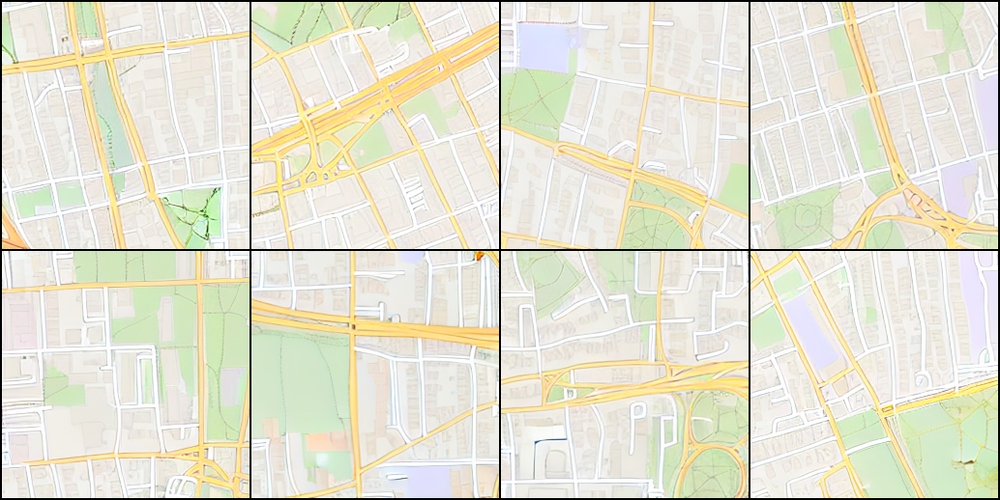

In [43]:
imgs = []
for i in range(2):
    generated = pipe(prompt=sentences[2].format(area_type="Seattle, USA, North America"), num_images_per_prompt=4, height=256, width=256).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=4)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

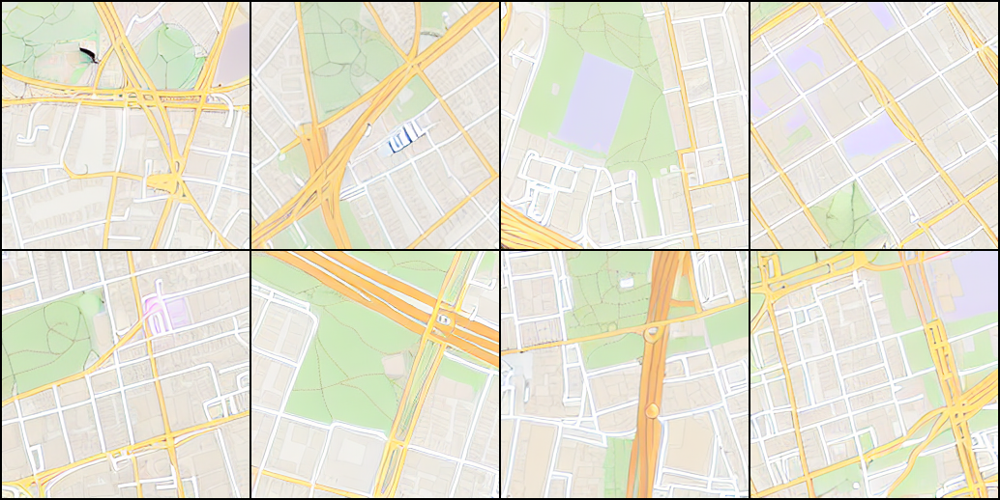

In [44]:
imgs = []
for i in range(2):
    generated = pipe(prompt=sentences[2].format(area_type="Los Angeles, PL, Europe"), num_images_per_prompt=4, height=256, width=256).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=4)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

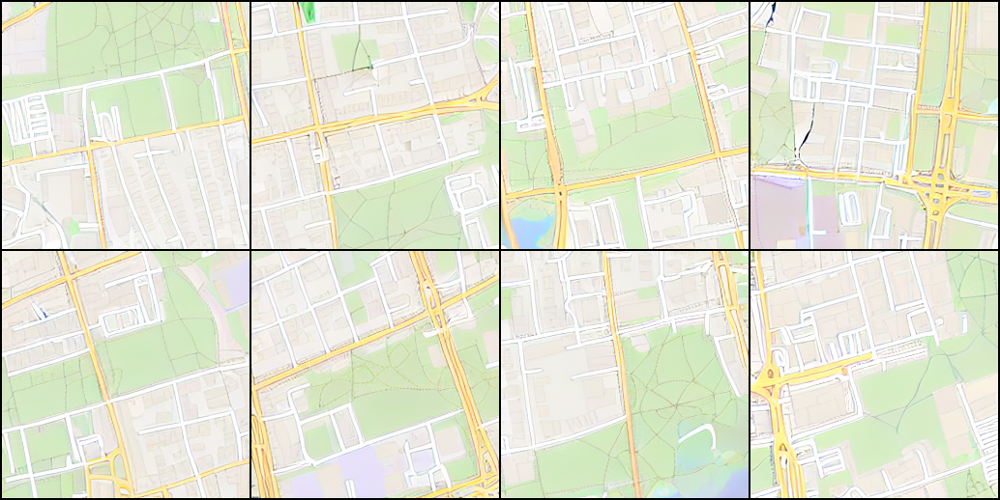

In [45]:
imgs = []
for i in range(2):
    generated = pipe(prompt=sentences[2].format(area_type="Seattle, Wroclaw"), num_images_per_prompt=4, height=256, width=256).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=4)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

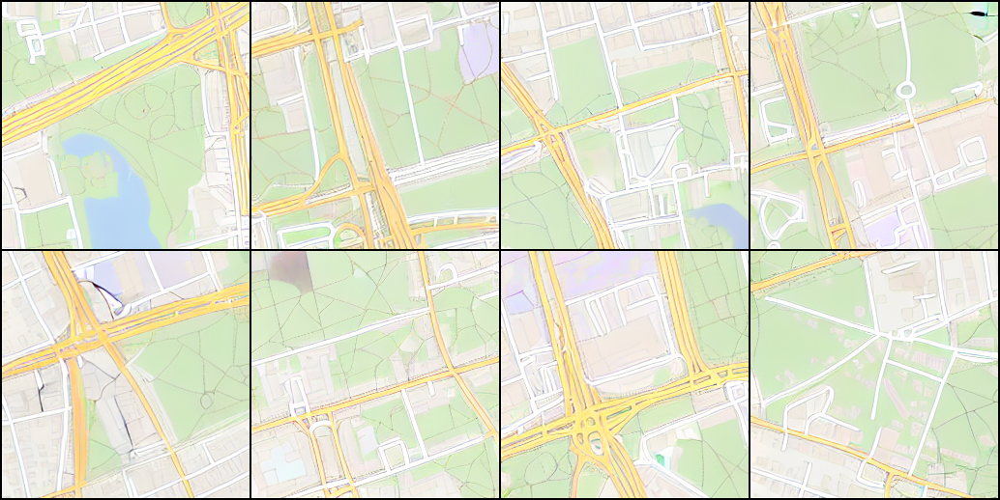

In [46]:
imgs = []
for i in range(2):
    generated = pipe(prompt=sentences[2].format(area_type="Wroclaw, PL, Europe"), height=256, width=256, num_images_per_prompt=4).images
    imgs.append(generated)
to_tensor = transforms.PILToTensor()
imgs = seq(imgs).flatten().map(lambda img: to_tensor(img)).to_list()
grid = make_grid(imgs, nrow=4)
transforms.ToPILImage()(grid)

  0%|          | 0/50 [00:00<?, ?it/s]

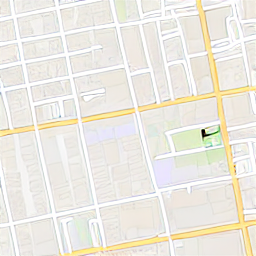

In [47]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, USA, Europe"), height=256, width=256).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

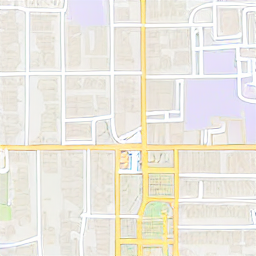

In [48]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, USA, North America"), height=256, width=256).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

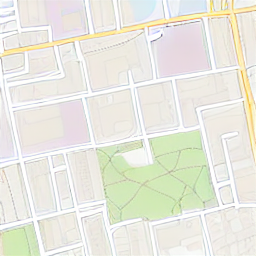

In [49]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, Poland, Europe"), height=256, width=256).images[0]

# Area types

In [50]:
cities_dict = {}
def read_city(admin):
    df = pd.read_pickle(f"../data/admins/{admin}")
    return df.groupby("name").count()["admin_region"]

for admin in os.listdir("../data/admins/"):
    df = read_city(admin)
    cities_dict[admin] = df.shape[0]
    


In [51]:
prompt = 'OSM from Stockholm, Sweden, Europe of {area_type} area containing: 1 amenity kindergarten, 2 landuse allotmentss , 1 building kindergarten, 2 amenity waste disposals , 1 shop beauty, 2 building retails , 1 landuse commercial, 2 amenity pharmacys , 3 amenity recyclings , 3 sport basketballs . '
prompt

'OSM from Stockholm, Sweden, Europe of {area_type} area containing: 1 amenity kindergarten, 2 landuse allotmentss , 1 building kindergarten, 2 amenity waste disposals , 1 shop beauty, 2 building retails , 1 landuse commercial, 2 amenity pharmacys , 3 amenity recyclings , 3 sport basketballs . '

In [52]:
data = pd.Series(data=cities_dict)
data[data == data.max()].index.item()

'Kraków, PL.pkl'

In [53]:
area_types = read_city(data[data == data.max()].index.item()).index
area_types.drop("city_block")

Index(['city', 'hamlet', 'locality', 'neighbourhood', 'quarter', 'suburb',
       'town', 'unknown', 'village'],
      dtype='object', name='name')

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

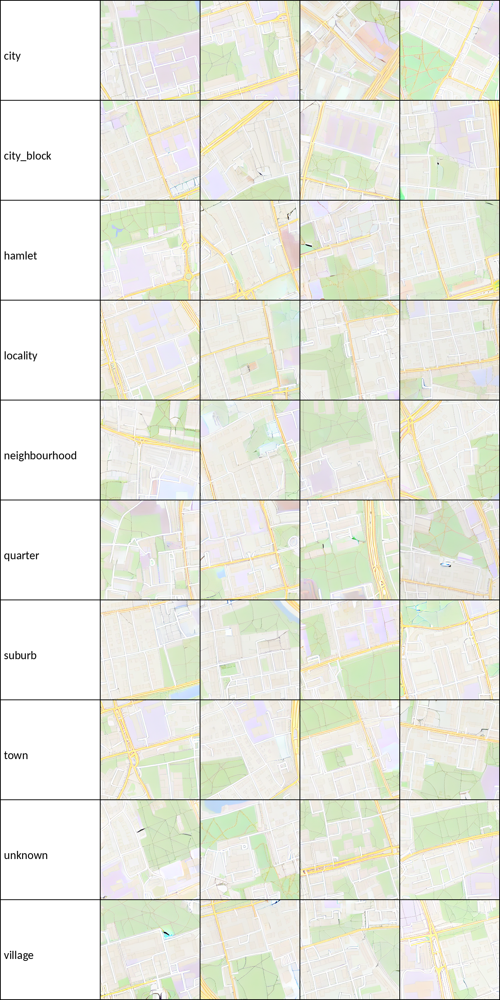

In [54]:
imgs = []
for area_type in area_types:
    imgs.append(generate_examples(prompt, [area_type] * 4, area_type))
list_to_grid(imgs, row=5)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

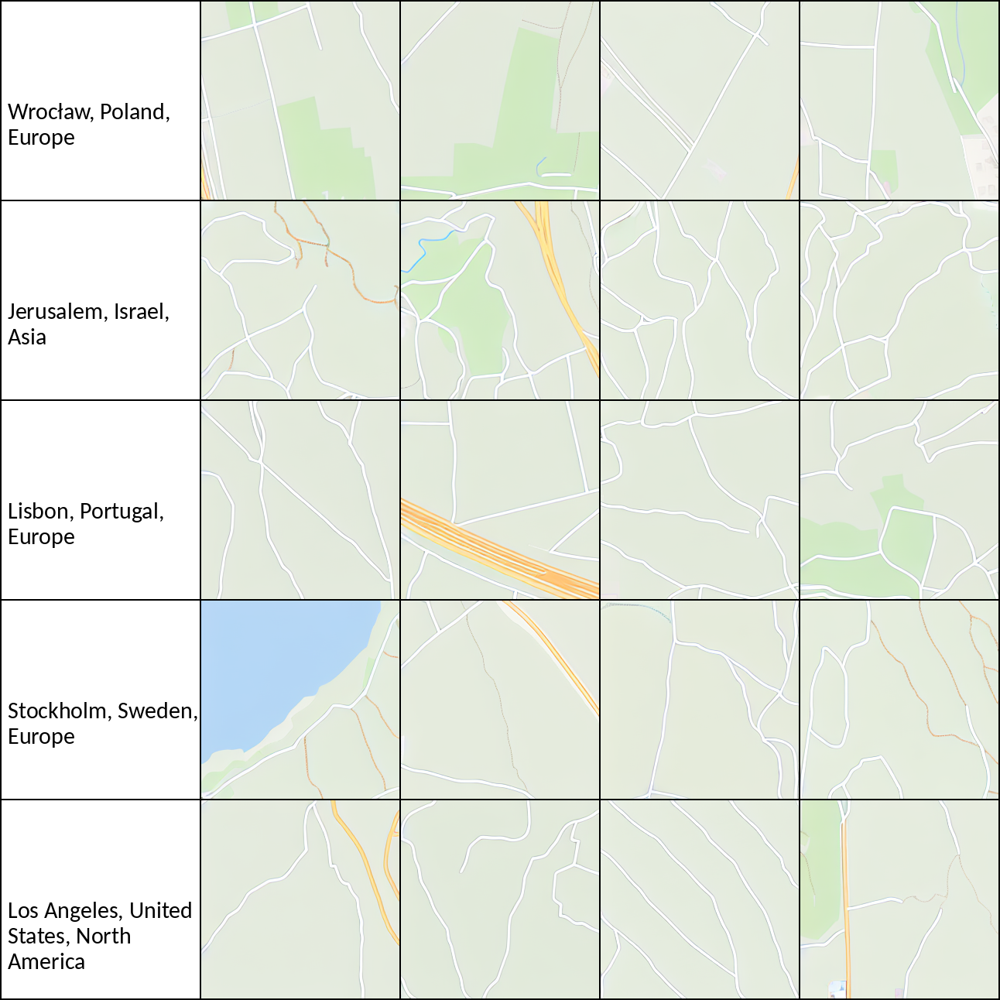

In [55]:
green_prompt = "OSM from {area_type}, Europe of city area containing: 1 highway track, 6 landuse forests , 3 highway footways , 1 buildings."

imgs = []
for area_type in cities:
    imgs.append(generate_examples(green_prompt, [area_type] * 4, area_type))
list_to_grid(imgs, row=5)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

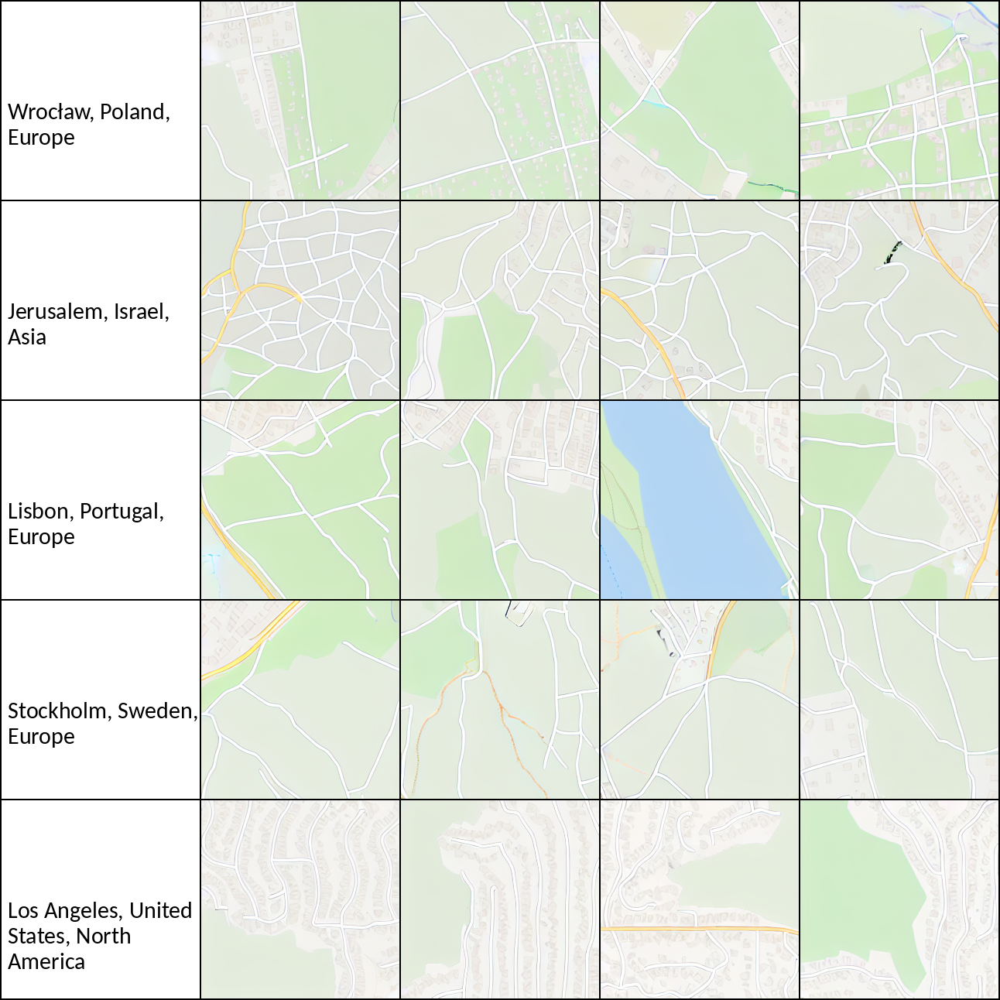

In [56]:
green_prompt = "OSM from {area_type}, Europe of city area containing: 1 highway track, 6 landuse forests , 3 highway footways , 100 buildings."

imgs = []
for area_type in cities:
    imgs.append(generate_examples(green_prompt, [area_type] * 4, area_type))
list_to_grid(imgs, row=5)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

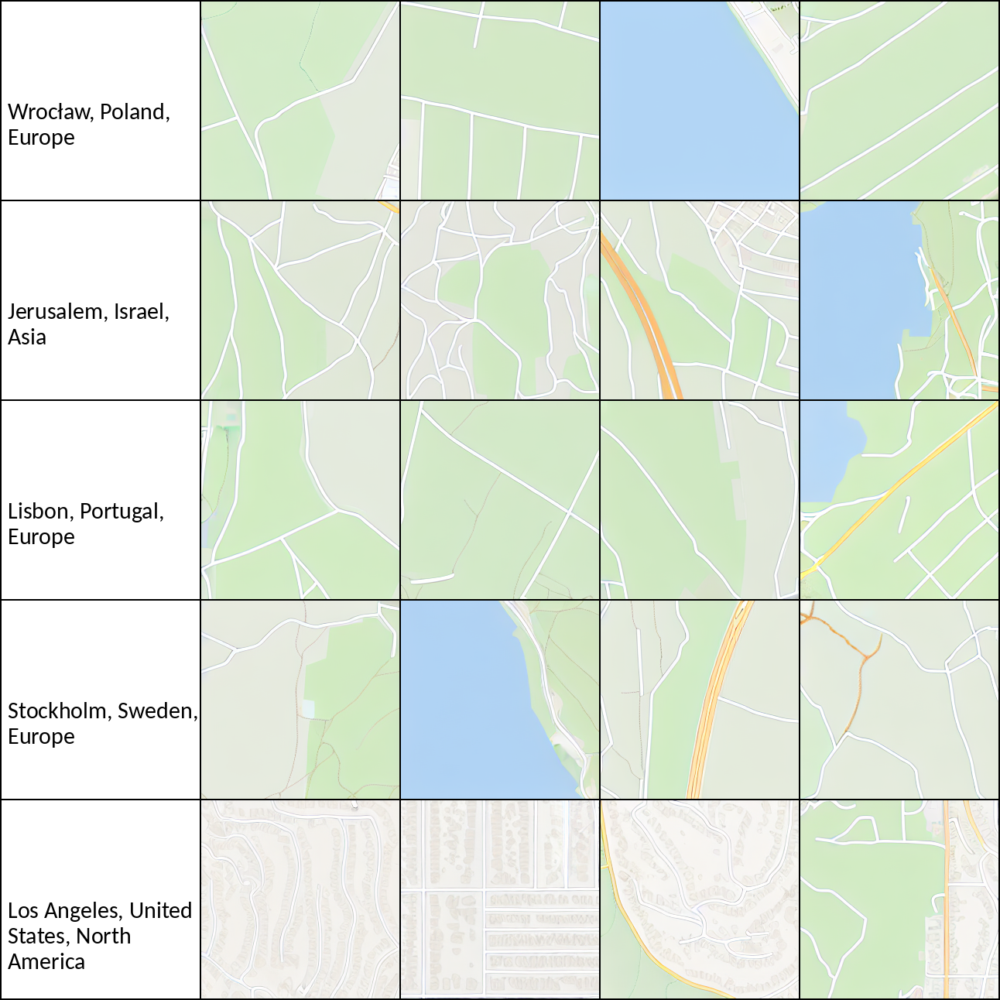

In [57]:
green_prompt = "OSM from {area_type}, Europe of city area containing: 1 highway track, 6 leisure parks , 3 highway footways , 1 building."

imgs = []
for area_type in cities:
    imgs.append(generate_examples(green_prompt, [area_type] * 4, area_type))
list_to_grid(imgs, row=5)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

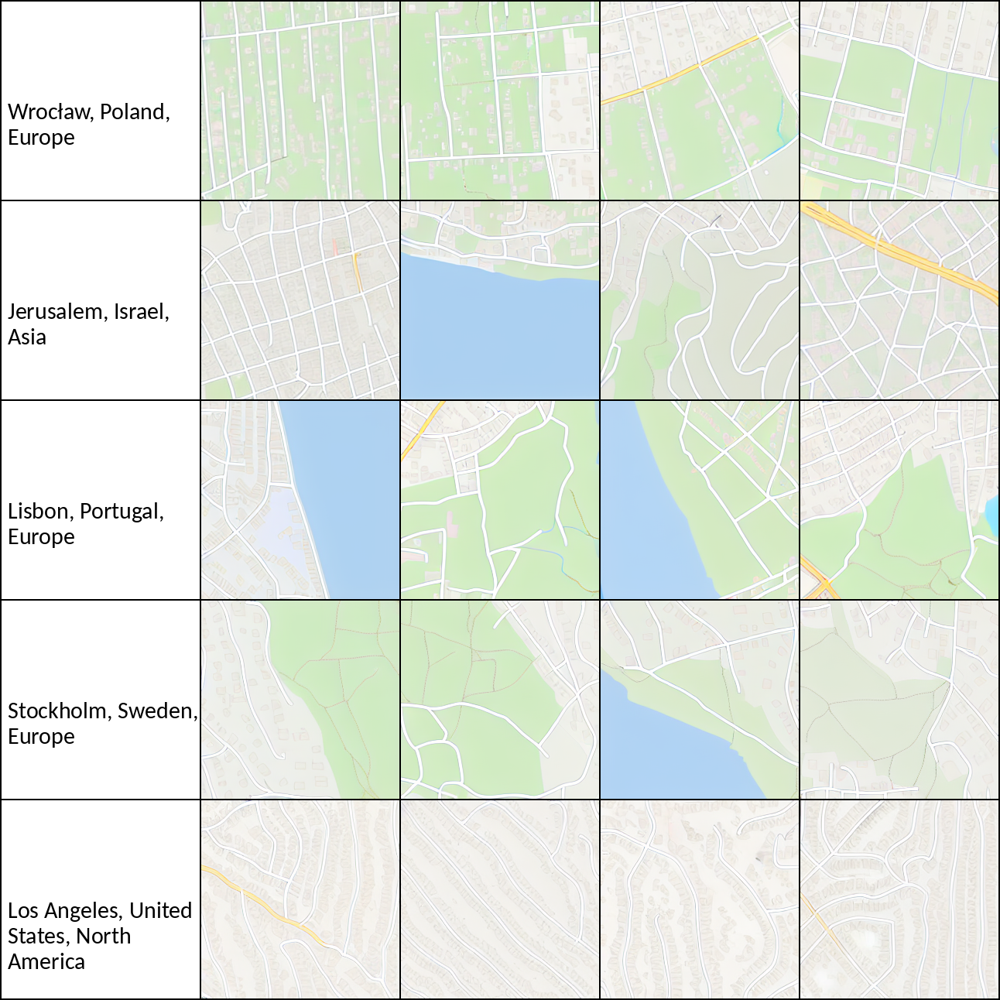

In [58]:
green_prompt = "OSM from {area_type}, Europe of city area containing: 1 highway track, 6 leisure parks , 3 highway footways , 100 buildings."

imgs = []
for area_type in cities:
    imgs.append(generate_examples(green_prompt, [area_type] * 4, area_type))
list_to_grid(imgs, row=5)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

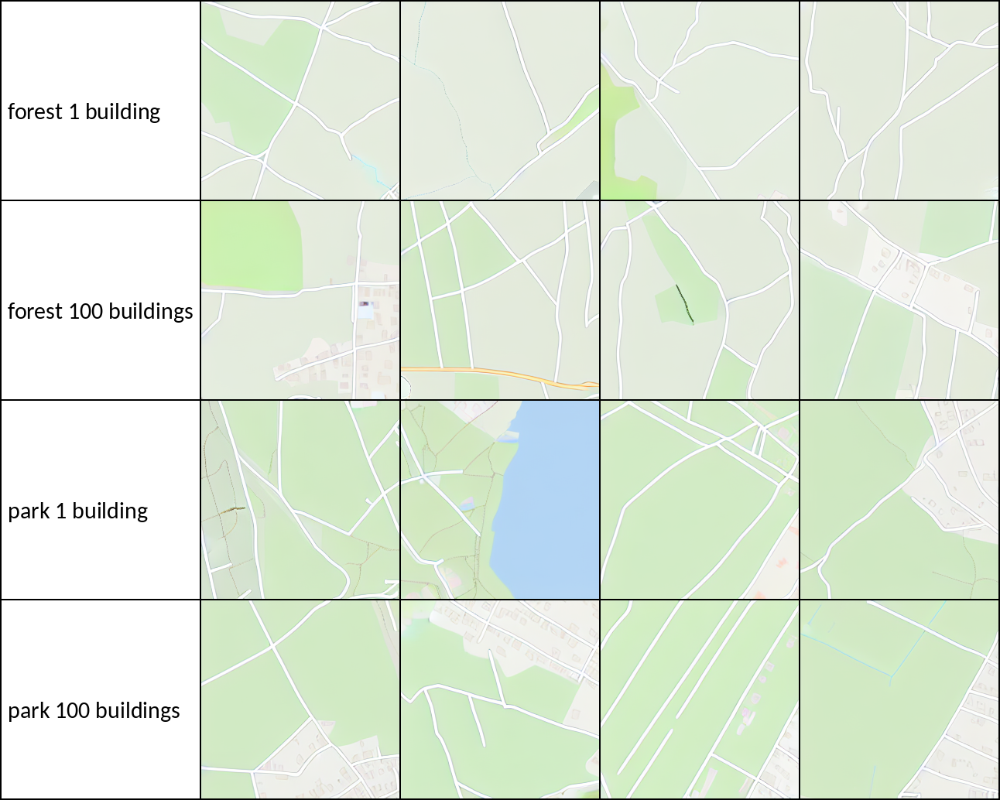

In [59]:
green_prompts = [
    "OSM from Kraków, Poland, Europe of city area containing: 1 highway track , 6 landuse forests , 3 highway footways , 1 building.",
    "OSM from Kraków, Poland, Europe of city area containing: 1 highway track , 6 landuse forests , 3 highway footways , 30 buildings.",
    "OSM from Kraków, Poland, Europe of city area containing: 1 highway track, 6 leisure parks , 3 highway footways , 1 building.",
    "OSM from Kraków, Poland, Europe of city area containing: 1 highway track, 6 leisure parks , 3 highway footways , 30 buildings.",
]

imgs = []
for (prompt, label) in zip(green_prompts, ["forest 1 building" , "forest 100 buildings", "park 1 building", "park 100 buildings"]):
    imgs.append(generate_examples(prompt, [""] * 4, label))
list_to_grid(imgs, row=5)